## **Installing necessary packages**

In [ ]:
!pip install -Uqq fastai fastbook nbdev

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.1/66.1 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 521.2/521.2 kB 19.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 21.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.7/58.7 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 22.0 MB/s eta 0:00:00


## **Using required imports and magic functions**

In [ ]:
import warnings
from fastai import *
from fastbook import *
from fastai.vision.all import *
warnings.filterwarnings('ignore')
from fastai.vision.widgets import *

%reload_ext autoreload
%autoreload 2
%matplotlib inline

## **Mounting Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

## **Intializing project folder path**

In [ ]:
%cd /content/drive/MyDrive/Bengali Fish Recognizer

## **Function to slice cleaner**

In [ ]:
def get_cleaner_range(data_path):

  available_images = get_image_files(data_path)
  cleaner_range = []

  for i in range(math.ceil(len(available_images)/200)):
    if i == 0:
      cleaner_range.append((0,0+200))
    else:
      cleaner_range.append((cleaner_range[i-1][0]+200,cleaner_range[i-1][1]+200))

  return available_images, cleaner_range

In [ ]:
data_path = "Data"

In [ ]:
available_images, cleaner_range = get_cleaner_range(data_path)
print(f"Number of available images: {len(available_images)}")
print(f"{cleaner_range}")

In [ ]:
cleaner = ImagesCleaner(max_n = 200, height=224, width=300)
cleaner.set_fns(available_images[2600:2800])
cleaner

Box(children=(VBox(children=(Output(layout=Layout(height='224px')), Dropdown(layout=Layout(width='max-content'…

## **Deleting redundant images**

In [ ]:
cleaner.delete()

(#1) [183]

In [ ]:
for id in cleaner.delete():
 os.remove(cleaner.fns[id])

## **Function to initialize or create a required directory**

In [ ]:
def folder_initialize(folder_path_name):
  if not os.path.exists(folder_path_name):
    os.mkdir(folder_path_name)

## **Categories in `Data` directory**

In [ ]:
labels = []
for label in os.listdir(data_path):
  labels.append(label)

## **Mapping category wise images numbers**

In [ ]:
data = {}
for label in labels:
  count = len([entry for entry in os.listdir(f"{data_path}/{label}") if os.path.isfile(os.path.join(f"{data_path}/{label}", entry))])
  data[label] = count

## **Function to show images distribution**

In [ ]:
def plot_images_distribution(dictionary):
  labels = dictionary.keys()
  number_of_images = dictionary.values()

  plt.bar(labels, number_of_images)
  plt.xlabel("Labels")
  plt.xticks(rotation=90)
  plt.ylabel("Number of images")
  plt.title("Image distribution")
  plt.show()

## **Viewing Image Distribution for each label**

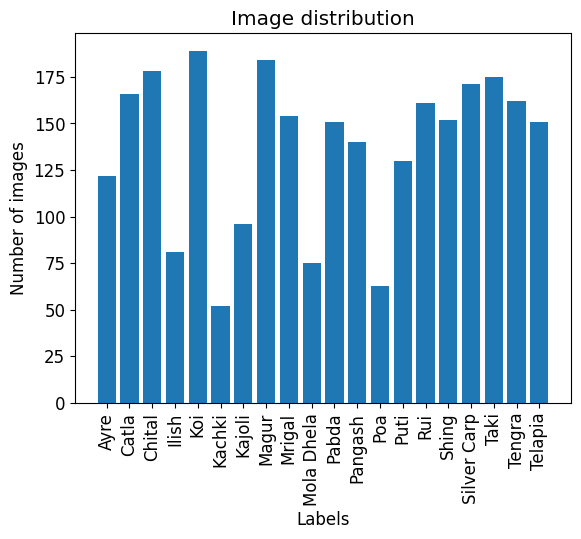

In [ ]:
plot_images_distribution(data)

## **Initialization of Data Loader Path**

In [ ]:
data_loader_path = 'DataLoaders'
folder_initialize(data_loader_path)

## **Initialization of Data Loader**

In [ ]:
data_block = DataBlock(
    blocks = (ImageBlock, CategoryBlock),
    splitter = RandomSplitter(valid_pct=0.2, seed = 42),
    get_items = get_image_files,
    get_y = parent_label,
    item_tfms=Resize(224),
    batch_tfms = aug_transforms()
)

## **Declaration of Batch Size**

In [ ]:
batch_size = 32

## **Creation of Data Loader**

In [ ]:
data_loader = data_block.dataloaders(data_path, bs=batch_size)

## **Declaration of Data Loader version**

In [ ]:
version = 4

## **Storing the dataloader**

In [ ]:
torch.save(data_loader, f"{data_loader_path}/DataLoader_v_{version}")

## **Loading the stored dataloader**

In [ ]:
data_loader = torch.load(f"{data_loader_path}/DataLoader_v_{version}")

## **Viewing train batches of the dataloader**

In [ ]:
data_loader.train.show_batch(max_n=20, nrows = 4)

## **Viewing validation batches of the dataloader**

In [ ]:
data_loader.valid.show_batch(max_n=20, nrows = 4)

In [ ]:
model = vision_learner(data_loader, densenet121, metrics = [error_rate, accuracy])

In [ ]:
model.load(f"DenseNet121_1")

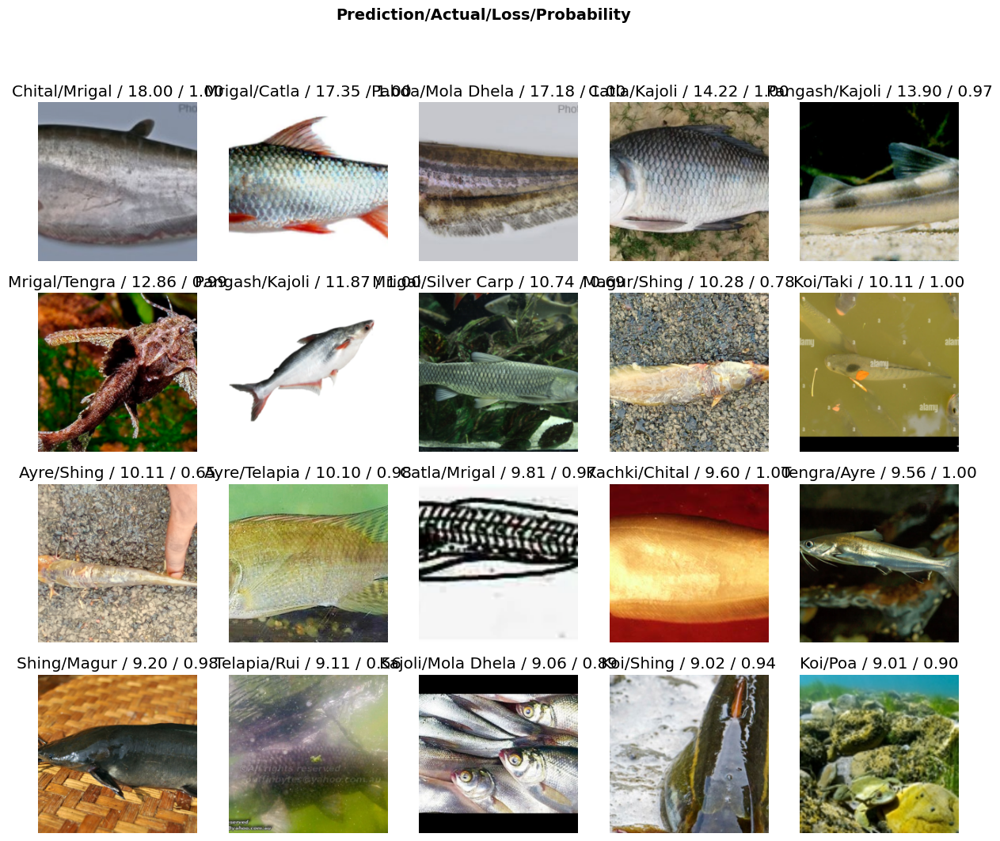

In [ ]:
interpreter = ClassificationInterpretation.from_learner(model)
interpreter.plot_top_losses(20, nrows=4)

## **Data cleaning based on losses**         

In [ ]:
# i ranges from 0 - 19
i = 14
dir_path = f"{data_path}/{dirs[i]}"
print(dir_path)

available_images, cleaner_range = get_cleaner_range(dir_path)
print(f"Number of available images: {len(available_images)}")
print(f"{cleaner_range}")

Data/Rui
Number of available images: 142
[(0, 200)]


In [ ]:
cleaner = ImagesCleaner(max_n = cleaner_range[0][1], height=224, width=300, opts=tuple(dirs))
cleaner.set_fns(available_images[cleaner_range[0][0]:cleaner_range[0][1]])
cleaner

Box(children=(VBox(children=(Output(layout=Layout(height='224px')), Dropdown(layout=Layout(width='max-content'…

In [ ]:
cleaner.delete()

(#17) [3,10,17,20,21,24,27,28,32,41...]

In [ ]:
cleaner.change()

(#2) [(9, 'Puti'),(13, 'Mrigal')]

In [ ]:
for id in cleaner.delete():
 os.remove(cleaner.fns[id])

for id, dir_name in cleaner.change():
  try:
    shutil.move(str(cleaner.fns[id]), f"{data_path}/{dir_name}")
  except:
    continue

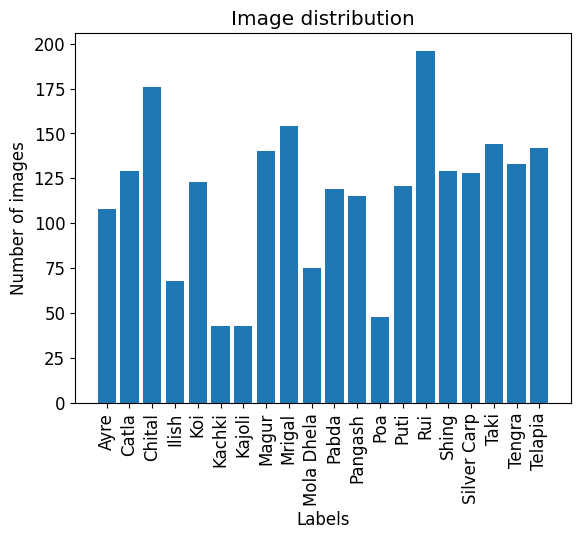

In [ ]:
plot_images_distribution(data)